# Setup 
### First we have so install needed libraries for the project

In [22]:
!pip install keras_bed_sequence
!pip install epigenomic_dataset
!pip install ucsc_genomes_downloader 
!pip install boruta
!pip install barplots
!pip install plot_keras_history
!pip install extra_keras_metrics -q 

In [2]:
from epigenomic_dataset import active_enhancers_vs_inactive_enhancers,active_promoters_vs_inactive_promoters
from sklearn.impute import KNNImputer
from sklearn.preprocessing import RobustScaler 
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from boruta import BorutaPy
from multiprocessing import cpu_count
import pandas as pd
import numpy as np
from tqdm.auto import tqdm
from tqdm.keras import TqdmCallback 
from barplots import barplots
from typing import Dict, List, Tuple, Optional
from cache_decorator import Cache
from matplotlib.axes import Axes
from matplotlib.figure import Figure
from matplotlib.colors import ListedColormap, LogNorm
from multiprocessing import cpu_count, Pool
from scipy.stats import distributions 
import seaborn as sns
from operator import lt, gt
from scipy import stats 
from scipy.stats import pearsonr, spearmanr, entropy, wilcoxon
import matplotlib
import matplotlib.pyplot as plt
from plot_keras_history import plot_history
from epigenomic_dataset import load_epigenomes
from epigenomic_dataset.utils import get_cell_lines 
import warnings
from epigenomic_dataset.utils import normalize_epigenomic_data
from ucsc_genomes_downloader import Genome
from keras_bed_sequence import BedSequence
from keras_mixed_sequence import MixedSequence, VectorSequence
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import StratifiedShuffleSplit, ShuffleSplit
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Dropout, BatchNormalization, ReLU, Concatenate, Layer
from tensorflow.keras.layers import Conv1D, MaxPool1D,AveragePooling1D, GlobalAveragePooling1D, GlobalMaxPool1D, Flatten
from tensorflow.keras import regularizers
from tensorflow.keras.models import Model
from extra_keras_metrics import get_complete_binary_metrics
from tensorflow.keras.utils import plot_model, Sequence
from tensorflow.keras.callbacks import EarlyStopping, Callback
import tsnecuda
from tsnecuda import TSNE 
import math
import operator
import gc
from sklearn.feature_selection import f_regression

# Retrieval epigenomic data  
#### In the following cell we want to retrieve epigenomic data of promoters and enhancers regions,the cell line considered is K562 and assembly genome is Hg38.


In [3]:
window_size = 256
cell_line = "K562"

In [4]:
# Retrieving the data

promoters_epigenomes, promoters_labels = active_promoters_vs_inactive_promoters(
    cell_line = cell_line,
    dataset = "fantom",
    assembly="hg38",
    binarize=True,
    min_active_tpm_value=1,
    max_inactive_tpm_value=1,
    window_size = window_size
)

enhancers_epigenomes, enhancers_labels = active_enhancers_vs_inactive_enhancers(
    cell_line = cell_line,
    dataset = "fantom",
    assembly="hg38",
    binarize=True,
    min_active_tpm_value=1,
    max_inactive_tpm_value=1,
    window_size = window_size
)

In [5]:
epigenomes = {
    "promoters": promoters_epigenomes,
    "enhancers": enhancers_epigenomes
}

labels = {
    "promoters": promoters_labels,
    "enhancers": enhancers_labels
}

In [6]:
for region in ("promoters","enhancers"):
    samples, features = epigenomes[region].shape
    print(f"There are {samples} samples and {features} features for {region} regions.")

There are 99881 samples and 429 features for promoters regions.
There are 63285 samples and 429 features for enhancers regions.


In [7]:
for region, x in epigenomes.items():
    print(
        f"The rate between features and samples for {region} data is: {x.shape[0]/x.shape[1]}"
    )
    print("="*80)

The rate between features and samples for promoters data is: 232.82284382284382
The rate between features and samples for enhancers data is: 147.5174825174825


# Imputation Nan values
#### Nan values present missing values in data and we want to identify empty values to impute in our dataset.
#### As we can see there are many Nan values in our dataset.

In [8]:
for region, x in epigenomes.items():
    print("\n".join((
        f"Nan values report for {region} data:",
        f"In the document there are {x.isna().values.sum()} NaN values out of {x.values.size} values.",
        f"The sample (row) with most values has {x.isna().sum(axis=0).max()} NaN values out of {x.shape[1]} values.",
        f"The feature (column) with most values has {x.isna().sum().max()} NaN values out of {x.shape[0]} values."
    )))
    print("="*80)
for region, x in labels.items():
    print("\n".join((
        f"Nan values report for {region} data:",
        f"In the document there are {x.isna().values.sum()} NaN values out of {x.values.size} values.",
        f"The sample (row) with most values has {x.isna().sum(axis=0).max()} NaN values out of {x.shape[1]} values.",
        f"The feature (column) with most values has {x.isna().sum().max()} NaN values out of {x.shape[0]} values."
    )))
    print("="*80) 

Nan values report for promoters data:
In the document there are 496 NaN values out of 42848949 values.
The sample (row) with most values has 250 NaN values out of 429 values.
The feature (column) with most values has 250 NaN values out of 99881 values.
Nan values report for enhancers data:
In the document there are 102 NaN values out of 27149265 values.
The sample (row) with most values has 93 NaN values out of 429 values.
The feature (column) with most values has 93 NaN values out of 63285 values.
Nan values report for promoters data:
In the document there are 0 NaN values out of 99881 values.
The sample (row) with most values has 0 NaN values out of 1 values.
The feature (column) with most values has 0 NaN values out of 99881 values.
Nan values report for enhancers data:
In the document there are 0 NaN values out of 63285 values.
The sample (row) with most values has 0 NaN values out of 1 values.
The feature (column) with most values has 0 NaN values out of 63285 values.


# KNN imputation(K-nearest neighbor imputation)
#### There are several solutions to Nan imputation that we have done KNN imputation.These approach keeps the obtain values in the cluster of the class of the most neighbouring the values.As we can see after running this method ,we don't have any Nan values in our dataset.


In [9]:
def knn_imputer(df:pd.DataFrame, neighbours:int=5)->pd.DataFrame:
    """Return provided dataframe with NaN imputed using knn.
    
    Parameters
    --------------------
    df:pd.DataFrame,
        The dataframe to impute.
    neighbours:int=5,
        The number of neighbours to consider.
        
    Returns
    --------------------
    The dataframe with the NaN values imputed.
    """
    return pd.DataFrame(
        KNNImputer(n_neighbors=neighbours).fit_transform(df.values),
        columns=df.columns,
        index=df.index
    )

In [10]:
for region, x in epigenomes.items():
    epigenomes[region] = knn_imputer(x)
    
for region, y in labels.items():
    labels[region] = knn_imputer(y)    


In [11]:
for region, x in epigenomes.items():
    print("\n".join((
        f"Nan values report for {region} data:",
        f"In the document there are {x.isna().values.sum()} NaN values out of {x.values.size} values.",
        f"The sample (row) with most values has {x.isna().sum(axis=0).max()} NaN values out of {x.shape[1]} values.",
        f"The feature (column) with most values has {x.isna().sum().max()} NaN values out of {x.shape[0]} values."
    )))
    print("="*80)
for region, x in labels.items():
    print("\n".join((
        f"Nan values report for {region} data:",
        f"In the document there are {x.isna().values.sum()} NaN values out of {x.values.size} values.",
        f"The sample (row) with most values has {x.isna().sum(axis=0).max()} NaN values out of {x.shape[1]} values.",
        f"The feature (column) with most values has {x.isna().sum().max()} NaN values out of {x.shape[0]} values."
    )))
    print("="*80) 

Nan values report for promoters data:
In the document there are 0 NaN values out of 42848949 values.
The sample (row) with most values has 0 NaN values out of 429 values.
The feature (column) with most values has 0 NaN values out of 99881 values.
Nan values report for enhancers data:
In the document there are 0 NaN values out of 27149265 values.
The sample (row) with most values has 0 NaN values out of 429 values.
The feature (column) with most values has 0 NaN values out of 63285 values.
Nan values report for promoters data:
In the document there are 0 NaN values out of 99881 values.
The sample (row) with most values has 0 NaN values out of 1 values.
The feature (column) with most values has 0 NaN values out of 99881 values.
Nan values report for enhancers data:
In the document there are 0 NaN values out of 63285 values.
The sample (row) with most values has 0 NaN values out of 1 values.
The feature (column) with most values has 0 NaN values out of 63285 values.


# Labels distribution:
#### Here we can see samples in each classe of  zero and one , in both figures (left and right) ,data are on bias and zero data are more than one that it has effect on model training and model will train on zero data and at the result in the test data ,the detection probability of model label zero instead of label one is more and here our task is regression and we don't have definition of distribution of classes in regression.

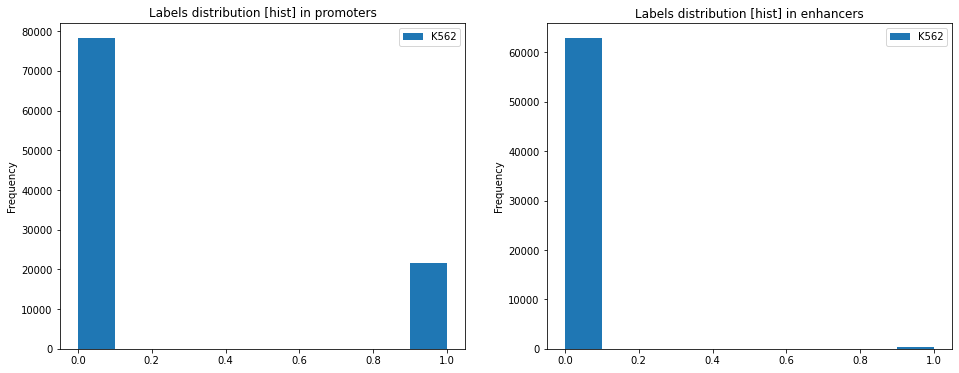

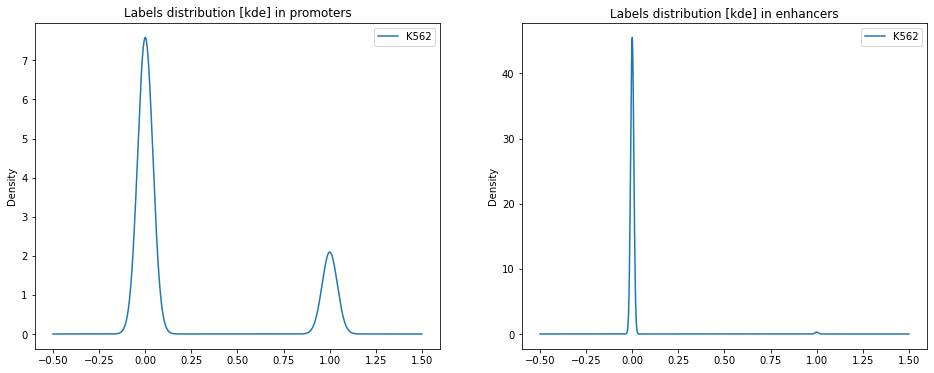

In [60]:
fig, axes = plt.subplots(ncols=2, figsize=(16,6))

for axis, (region, y) in zip(axes.ravel(), labels.items()):
    y.plot(kind='hist', ax=axis)
    axis.set_title(f"Labels distribution [hist] in {region}")
fig.show()


fig, axes = plt.subplots(ncols=2, figsize=(16,6))

for axis, (region, y) in zip(axes.ravel(), labels.items()):
    y.plot(kind='kde', ax=axis)
    axis.set_title(f"Labels distribution [kde] in {region}")
plt.show()

# Constant Features:
#### Constant feature indicate two columns that are identical, fortunately in our dataset we don't have identical columns , if we had these columns they cause to different experiments

In [13]:
def drop_constant_features(df:pd.DataFrame)->pd.DataFrame:
    """Return DataFrame without constant features."""
    return df.loc[:, (df != df.iloc[0]).any()]

In [14]:
for region, x in epigenomes.items():
    result = drop_constant_features(x)
    if x.shape[1] != result.shape[1]:
        print(f"Features in {region} were constant and had to be dropped!")
        epigenomes[region] = result
    else:
        print(f"No constant features were found in {region} region!")
        
for region, x in labels.items():
    result = drop_constant_features(x)
    if x.shape[1] != result.shape[1]:
        print(f"Features in {region} were constant and had to be dropped!")
        epigenomes[region] = result
    else:
        print(f"No constant features were found in {region} labels!")        

No constant features were found in promoters region!
No constant features were found in enhancers region!
No constant features were found in promoters labels!
No constant features were found in enhancers labels!


# Data Scaling:
#### Data Scaling is an approach to scaling the data using robust features that tries to ignore defect of outliers.
## Robust Scaler:
#### Now we want to use Robust Sklearn that it is a formal sklearn that defines the quantile when we want to normalize the data.

In [15]:
def robust_zscoring(df:pd.DataFrame)->pd.DataFrame:
    return pd.DataFrame(
        RobustScaler().fit_transform(df.values),
        columns=df.columns,
        index=df.index
    )

# Dictionary comprehension
epigenomes = {
    region: robust_zscoring(x)
    for region, x in epigenomes.items()
}

labels = {
    region: robust_zscoring(y)
    for region, y in labels.items()
}


# Linear Correlation :Pearson correlation coefficient:
#### The Pearson correlation test is very nice and we use now scipy implementation of Pearson ,scipy is a standard library which has statistical tools to run this type of test ,we want to check any given column ,for example if we have two columns ,that have extremely highly correlated.
#### As we can see below there are several features that do not have correlation and we drop them from enhancers and promoters.


In [58]:
p_value_threshold = 0.01
correlation_threshold  = 0.05

In [59]:
uncorrelated = {
    region: set()
    for region in epigenomes
}

In [60]:
for region, x in epigenomes.items():
    for column in tqdm(x.columns, desc=f"Running Pearson test for {region}", dynamic_ncols=True, leave=False):
        correlation, p_value = pearsonr(x[column].values.ravel(), labels[region].values.ravel())
        if p_value > p_value_threshold:
            print(region, column, correlation, "pvalue", p_value)
            uncorrelated[region].add(column)           

Running Pearson test for promoters:   0%|                                                      | 0/429 [00:00<…

promoters ZNF785 -0.004066654904761061 pvalue 0.19871785034981493


Running Pearson test for enhancers:   0%|                                                      | 0/429 [00:00<…

enhancers STAG1 -0.004000909943252502 pvalue 0.3141878715909758
enhancers RBM34 0.007574479426943337 pvalue 0.056719734028049994
enhancers XRCC3 0.00559390577497511 pvalue 0.1593637387971633
enhancers ZKSCAN3 0.008325574077091185 pvalue 0.03622268875911463
enhancers ILK -0.001000185497058124 pvalue 0.8013449567695253
enhancers ZNF830 -0.008763936371757835 pvalue 0.02747520052310545
enhancers H3K36me3 0.004985290937646062 pvalue 0.20980266631969433
enhancers H3K9me3 -0.009178192758921034 pvalue 0.020948242487033555
enhancers HNRNPH1 0.0018327113634462044 pvalue 0.6447717012356111
enhancers RBM17 -0.0071650974156932095 pvalue 0.0714705495532607
enhancers ZNF778 -0.005372511432979704 pvalue 0.176529097623114
enhancers SNRNP70 0.005817879928547883 pvalue 0.1433144744411365
enhancers PCBP2 0.008409410665760925 pvalue 0.034386515542200374
enhancers ATF2 0.010236878244116723 pvalue 0.010016536515492476
enhancers ZNF408 0.006294972204056818 pvalue 0.11328939043790945
enhancers MCM2 -0.00964726

In [61]:
for region, x in epigenomes.items():
    for column in tqdm(x.columns, desc=f"Running Spearman test for {region}", dynamic_ncols=True, leave=False):
        correlation, p_value = spearmanr(x[column].values.ravel(), labels[region].values.ravel())
        if p_value > p_value_threshold:
            print(region, column, correlation)
            uncorrelated[region].add(column)

Running Spearman test for promoters:   0%|                                                     | 0/429 [00:00<…

promoters THRAP3 0.0023890854986367126
promoters NCOA4 0.0015757392600128511


Running Spearman test for enhancers:   0%|                                                     | 0/429 [00:00<…

enhancers STAG1 -0.0025994774489953715
enhancers RBM34 0.0076753570217031886
enhancers XRCC3 0.007787966266958954
enhancers ZKSCAN3 0.009323482474508819
enhancers ILK -0.001770112808444864
enhancers ZNF830 -0.008175532618268947
enhancers H3K36me3 0.005187007736965364
enhancers HNRNPH1 0.002497006337045713
enhancers U2AF2 -0.007616520362904695
enhancers RBM17 -0.006328126200724515
enhancers whole-genome shotgun bisulfite sequencing -0.008990220921801987
enhancers ZNF778 -0.0062603600957990245
enhancers SNRNP70 0.0071553255016803645
enhancers PCBP2 0.008792293690517813
enhancers ZNF408 0.0061410861065352125
enhancers FOXJ3 -0.00528623952614889
enhancers ZBTB8A 0.003637678229009293
enhancers SRSF7 -0.009877359952431292
enhancers ZNF318 -0.0017634366756656434
enhancers DLX4 -0.006578950048960958
enhancers NFE2L1 0.008070141110141255
enhancers ZNF280A 0.0011266257500195246
enhancers FOXA1 -0.007188272752489385
enhancers THRA -0.007118595409285687
enhancers MCM7 0.0004349029196875116
enhance

#### Now we run this filter drop to columns that we want to remove and pass it to feature correlation.

In [64]:
for region, x in epigenomes.items():
    for column in tqdm(x.columns, dynamic_ncols=True, leave=True):
        epigenomes[region] =x.drop(columns=[col for col in uncorrelated[region] if col in x.columns])

  0%|                                                                                          | 0/426 [00:00<…

  0%|                                                                                          | 0/397 [00:00<…

# High correlated features
### We want to identify very high correlated that are 0.95 ,and spearman says that are correlated.In addition ,we identified there are two extremely correlated features which have correlation score 0.96 and 0.95 which basically are extremely high correlation ,so we pass it to some visualization of correlations.Using seaborn is handy tool in our Python toolbox to do also visualization ,we now display the top five scatter plot  of correlated features.



In [65]:
p_value_threshold = 0.01
correlation_threshold = 0.95

In [66]:
extremely_correlated = {
    region: set()
    for region in epigenomes
}

scores = {
    region: []
    for region in epigenomes
}

for region, x in epigenomes.items():
    for i, column in tqdm(
        enumerate(x.columns),
        total=len(x.columns), desc=f"Running Pearson test for {region}", dynamic_ncols=True, leave=True):
        for feature in x.columns[i+1:]:
            correlation, p_value = pearsonr(x[column].values.ravel(), x[feature].values.ravel())
            correlation = np.abs(correlation)
            scores[region].append((correlation, column, feature))
            if p_value < p_value_threshold and correlation > correlation_threshold:
                print(region, column, feature, correlation)
                if entropy(x[column]) > entropy(x[feature]):
                    extremely_correlated[region].add(feature)
                else:
                    extremely_correlated[region].add(column)

Running Pearson test for promoters:   0%|                                                      | 0/426 [00:00<…

promoters RBFOX2 POLR2G 0.9632970639849394


Running Pearson test for enhancers:   0%|                                                      | 0/397 [00:00<…

enhancers TCF12 CBFA2T3 0.9517533601546022


### So we can see that spearman couldn't find correlation between features

In [67]:
extremely_correlated = {
    region: set()
    for region in epigenomes
}

scores = {
    region: []
    for region in epigenomes
}

for region, x in epigenomes.items():
    for i, column in tqdm(
        enumerate(x.columns),
        total=len(x.columns), desc=f"Running Spearman test for {region}", dynamic_ncols=True, leave=True):
        for feature in x.columns[i+1:]:
            correlation, p_value = spearmanr(x[column].values.ravel(), x[feature].values.ravel())
            correlation = np.abs(correlation)
            scores[region].append((correlation, column, feature))
            if p_value < p_value_threshold and correlation > correlation_threshold:
                print(region, column, feature, correlation)
                if entropy(x[column]) > entropy(x[feature]):
                    extremely_correlated[region].add(feature)
                else:
                    extremely_correlated[region].add(column)

Running Spearman test for promoters:   0%|                                                     | 0/426 [00:00<…

Running Spearman test for enhancers:   0%|                                                     | 0/397 [00:00<…

#### Then we want to plot correlation ,we can see that those are vertical are not correlated.

In [ ]:
scores = {
    region:sorted(score, key=lambda x: np.abs(x[0]), reverse=True)
    for region, score in scores.items()
}

Most correlated features from promoters epigenomes


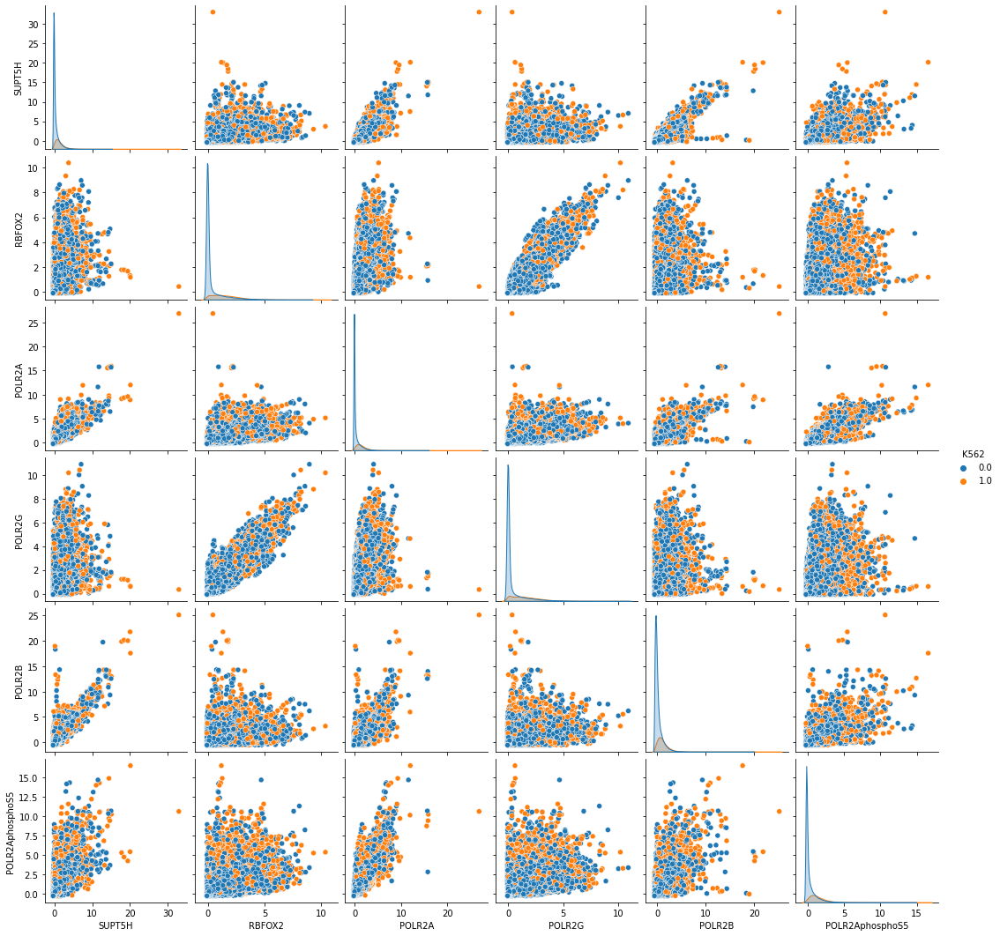

Most correlated features from enhancers epigenomes


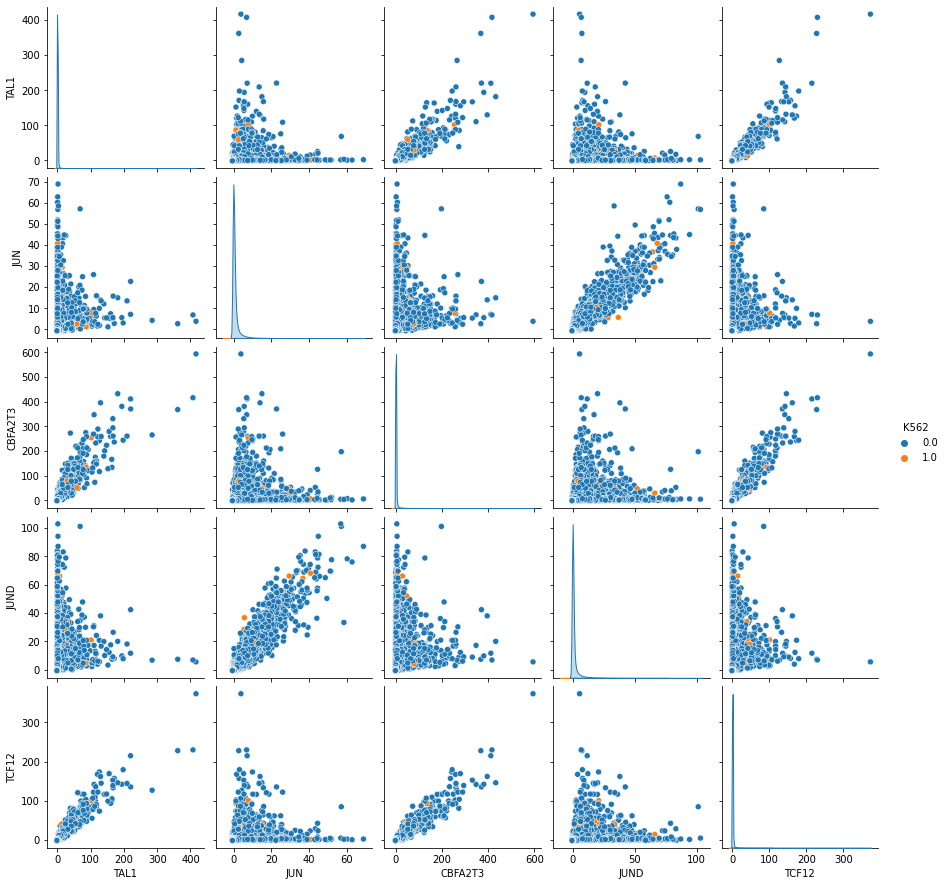

In [ ]:
for region, x in epigenomes.items():
    _, firsts, seconds = list(zip(*scores[region][:3]))
    columns = list(set(firsts+seconds))
    print(f"Most correlated features from {region} epigenomes")
    sns.pairplot(pd.concat([
        x[columns],
        labels[region],
    ], axis=1), hue=labels[region].columns[0])
    plt.show()

Least correlated features from promoters epigenomes


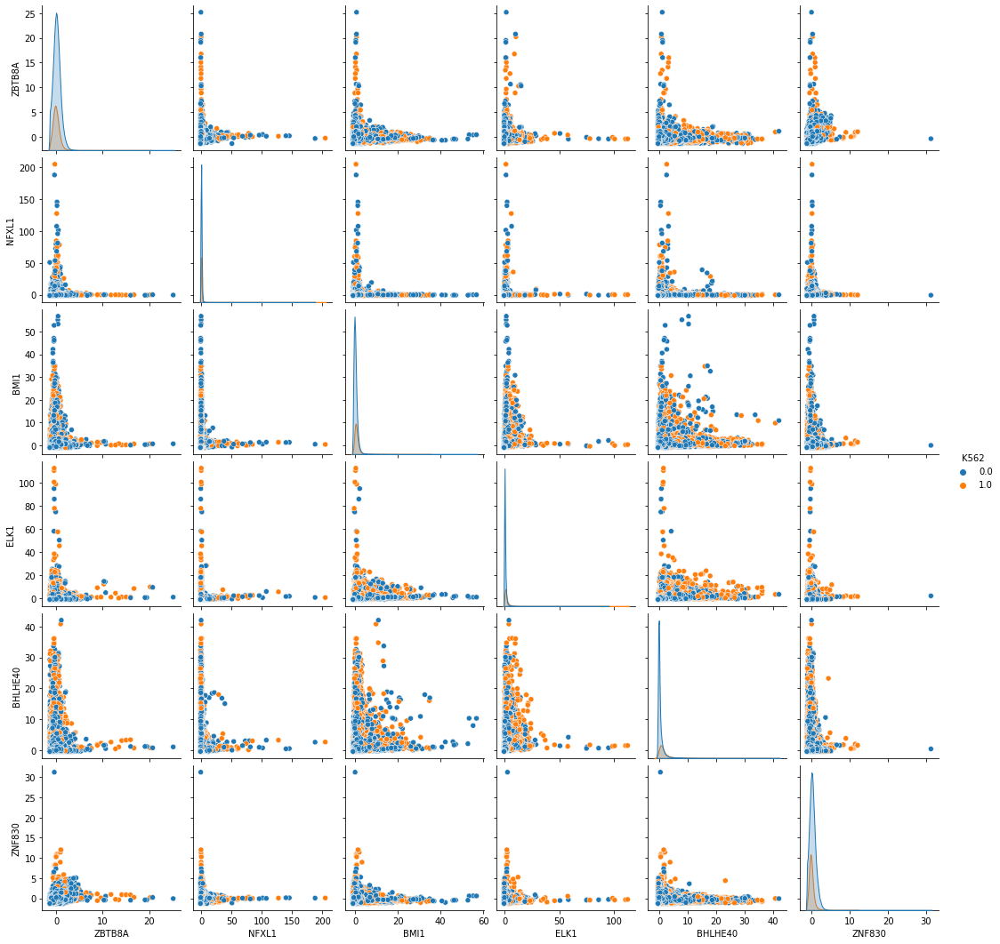

Least correlated features from enhancers epigenomes


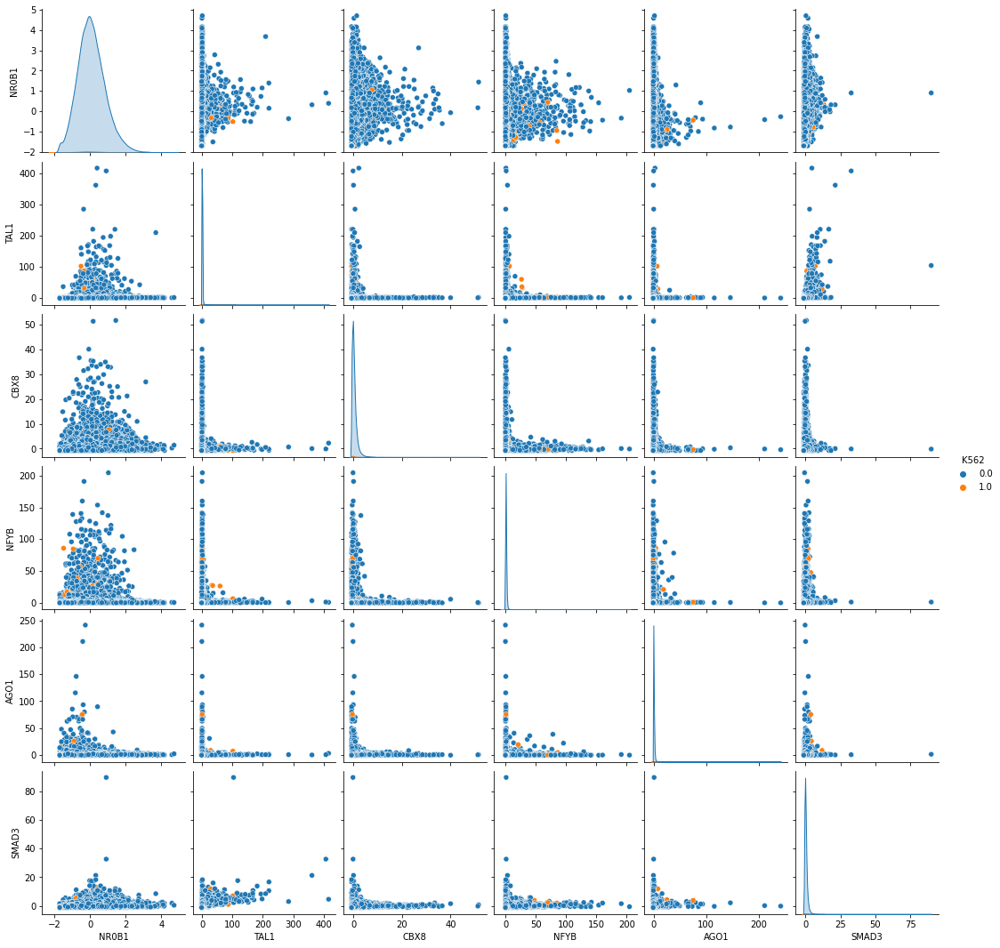

In [ ]:
for region, x in epigenomes.items():
    _, firsts, seconds = list(zip(*scores[region][-3:]))
    columns = list(set(firsts+seconds))
    print(f"Least correlated features from {region} epigenomes")
    sns.pairplot(pd.concat([
        x[columns],
        labels[region],
    ], axis=1), hue=labels[region].columns[0])
    plt.show()

# Features distributions:
### After having done filtering the above ,we have to do feature distribution,we want to understand how the features actually distributed.

Top 5 different features from promoters.


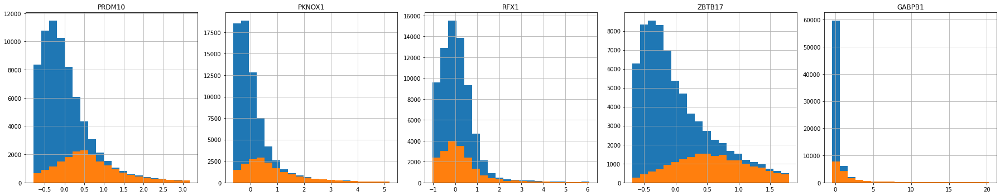

Top 5 different features from enhancers.


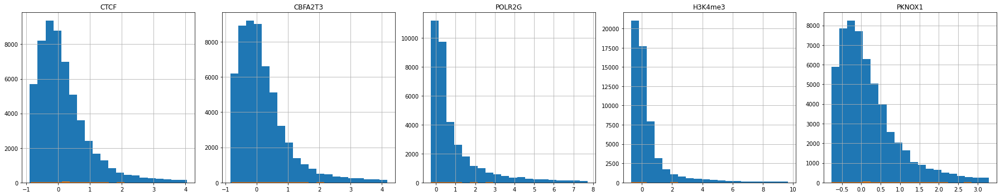

In [ ]:
def get_top_most_different(dist, n:int):
    return np.argsort(-np.mean(dist, axis=1).flatten())[:n]

top_number = 5

for region, x in epigenomes.items():
    dist = euclidean_distances(x.T)
    most_distance_columns_indices = get_top_most_different(dist, top_number)
    columns = x.columns[most_distance_columns_indices]
    fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(25, 5))
    print(f"Top {top_number} different features from {region}.")
    for column, axis in zip(columns, axes.flatten()):
        head, tail = x[column].quantile([0.05, 0.95]).values.ravel()
        
        mask = ((x[column] < tail) & (x[column] > head)).values
        
        cleared_x = x[column][mask]
        cleared_y = labels[region].values.ravel()[mask]
        
        cleared_x[cleared_y==0].hist(ax=axis, bins=20)
        cleared_x[cleared_y==1].hist(ax=axis, bins=20)

        axis.set_title(column)
    fig.tight_layout()
    plt.show()

# Feature selection with Spearman:
#### Spearman is a technique for automatic feature selection that is one of the important tools that we have .All those methods that we had before to execute feature selection like correlation with the output and correlation with the features , can be some automated with Spearman.
 #### (Given that Boruta is expensive from computational perspective we skipped it and we have done spearman feature selection)

In [13]:
def spearman_feature_selection(train_x, train_y, n_features=429):
    f_val, _ = f_regression(train_x,train_y)
    f_val_dict = {}
    for i in range(len(f_val)):
        if math.isnan(f_val[i]):
            f_val[i] = 0.0
        f_val_dict[i] = f_val[i]
    
    sorted_inds = np.argsort(-np.array(list(f_val_dict.values())))
    feature_indexs = np.array(list(range(train_X.shape[1])))
    
    return feature_indexs[sorted_inds[:n_features]]

# Retrieving the genomic sequences
### Here we can retrive sequence data enhancers and promoters regions that are downloaded from  ucsc_genomes_downloader package.

In [14]:
genome = Genome("hg38")

Loading chromosomes for genome hg38:   0%|                                                      | 0/25 [00:00<…

In [ ]:
genome

Human, Homo sapiens, hg38, 2013-12-15, 25 chromosomes

In [15]:
def to_bed(data:pd.DataFrame)->pd.DataFrame:
    """Return bed coordinates from given dataset."""
    return data.reset_index()[data.index.names]

In [16]:
genome.bed_to_sequence(to_bed(y))

array(['TTCTTGAGCTAGAGAGGGCCCAGTTattttacagatgaggaaacgaagactcagggaagaattatggtgtgagtcacacagctctagcttgaaaaggtctccctgactcagcccttgtcctcttcctgtctattctcaacccagcagccagttatccttttaaaacataagtcatcatcaacttcactgttcaaagctctccaacggcttccccctcactcagtgtaaaggccaaaatccttacaatgacctacac',
       'caggcggatcacctgaagtcaggagCCAGAAAAGAGGAAGAGATTGATGGAACGTTGAGGGAAATGCCCTGCCTTGGGGCTGCAAGACAAATAAATAACTGGTGCATATTTAAACAGATCGTTTATGAAGATTATTATTATCTCAGCCAAAAAATACACAATATGAACACTGTATAAAAGTCAATTTATCACATTCTCTGAGTCAGACTGTTCTTGGCTTATTGCAAAAGTTATCAGTGCACTGCACGAACCCCGT',
       'gaaagaaTCAGCCATGTAaagagctcttcaggcaggagaaactgcaggtgcaaaatcttgaagtagaaagccatctagtacgtttcggaaacacaaaataagccatgtgaacaaaggaggcagttttatgagatcagattagaaaacaaacagggccaggtgcagtgtcacgcatctgtaatcccagctactttggagggtgaggtgagaggctcacttgagcccagaagttcaagattgcagcacattatgattg',
       ...,
       'GATTCAGGTCCTCAGGAGGAGAAACAAAGGGTACATTCTCAGCATTCTCTGAGATTTACTTTCCCAGAAATGAAACAGCAAAGGCCAAAAGAATTGTTTTTCTTGCATCACTTGACCCTGAATTATCAGGGCTGATTCATTCAGTCACCTGTGCTGCTCATAAGTACTTGGGAGTACAG

In [17]:
np.array(BedSequence(
    genome,
    bed=to_bed(y),
    batch_size=1
))

array([[[[1., 0., 0., 0.],
         [0., 0., 0., 1.],
         [0., 0., 0., 1.],
         ...,
         [0., 0., 0., 1.],
         [0., 0., 0., 1.],
         [0., 0., 1., 0.]]],


       [[[1., 0., 0., 0.],
         [1., 0., 0., 0.],
         [0., 0., 0., 1.],
         ...,
         [0., 1., 0., 0.],
         [1., 0., 0., 0.],
         [1., 0., 0., 0.]]],


       [[[0., 0., 0., 1.],
         [0., 0., 1., 0.],
         [0., 1., 0., 0.],
         ...,
         [0., 0., 1., 0.],
         [0., 1., 0., 0.],
         [1., 0., 0., 0.]]],


       ...,


       [[[0., 0., 0., 1.],
         [0., 0., 1., 0.],
         [0., 0., 1., 0.],
         ...,
         [0., 1., 0., 0.],
         [1., 0., 0., 0.],
         [0., 0., 0., 1.]]],


       [[[1., 0., 0., 0.],
         [1., 0., 0., 0.],
         [0., 0., 1., 0.],
         ...,
         [0., 0., 0., 1.],
         [0., 0., 0., 1.],
         [0., 0., 1., 0.]]],


       [[[0., 0., 0., 1.],
         [0., 0., 0., 1.],
         [0., 0., 0., 1.],
     

# Features visualization using t-SNE :
### There are some visualization techniques for multidimensional vectors for instance PCA(Principal component analysis) and TSNE(t-distributed stochastic neighbor embedding) that here we have used t-SNE.

In [38]:
# Here we need to use the cached decomposition because computing
# TSNE decompositions can get very expensive computationally
# I provide the TSNE decomposition within the course repository.
@Cache(
    cache_path="decompositions/tsne/{data_type}_{region}_{cell_line}_{metric}.pkl.gz",
    # We do not want to include the X variable into the hash
    args_to_ignore=["X"],
)
def get_tsne_decomposition(
    X: pd.DataFrame,
    data_type: str,
    region: str,
    cell_line: str,
    metric: str,
)->pd.DataFrame:
    """Return the 2D TSNE decomposition of the given data."""
    # The import of the TSNECUDA is within the method and not
    # outside because it is hard to install the package
    from tsnecuda import TSNE
    return pd.DataFrame(
        TSNE(
            # Better performance may be achieved with cosine distance,
            # but currently TSNECUDA does not support other metrics.
            # Expecially for the sequence data, cosine distances may be foundamental
            # to get a semantically significant decomposition.
            perplexity= 100,
            n_iter = 1000,
            metric=metric,
            verbose=True
        ).fit_transform(X.values),
        index=X.index
    )

In [37]:
@Cache(
    cache_path="decompositions/pca/{data_type}_{region}_{cell_line}_{metric}.pkl.gz",
    # We do not want to include the X variable into the hash
    args_to_ignore=["X"],
)
def get_pca_decomposition(
    X: pd.DataFrame,
    data_type: str,
    region: str,
    cell_line: str,
    metric: str,
    **kwargs
) -> pd.DataFrame:
    """Return the 2D TSNE decomposition of the given data."""
    return pd.DataFrame(
        PCA(n_components=2).fit_transform(X.values),
        index=X.index
    )

In [36]:
def scatter_with_heatmap(
    decomposition: pd.DataFrame,
    scores: np.ndarray,
    figure: Figure,
    ax: Axes
):
    scatter = ax.scatter(
        *decomposition.values.T,
        c=scores,
        cmap=plt.cm.get_cmap('RdYlBu'),
        norm=LogNorm(),
        s=3
    )
    color_bar = figure.colorbar(scatter, ax=ax)

In [ ]:
from epigenomic_dataset.utils import get_cell_lines
get_cell_lines()

['A549', 'GM12878', 'H1', 'HEK293', 'HepG2', 'K562', 'MCF-7']

Computing decompositions:   0%|          | 0/7 [00:00<?, ?it/s]

Metrics:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Metrics:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Metrics:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Metrics:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Metrics:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Metrics:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Metrics:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Decomposition method:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

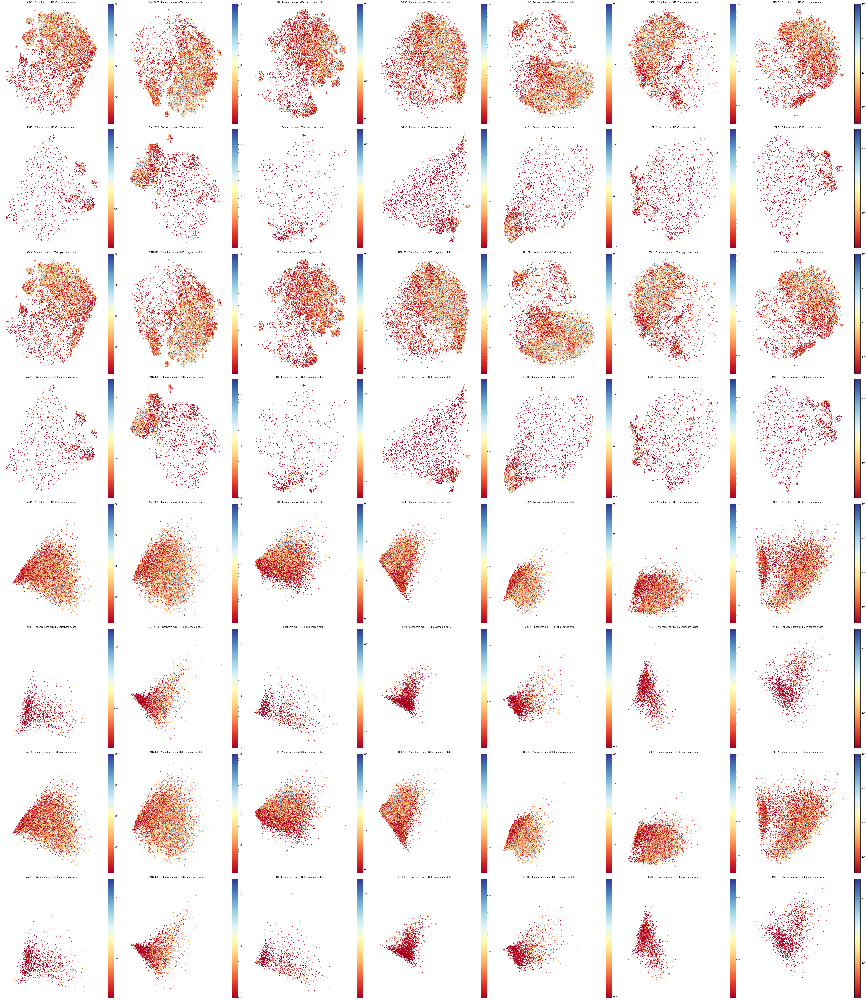

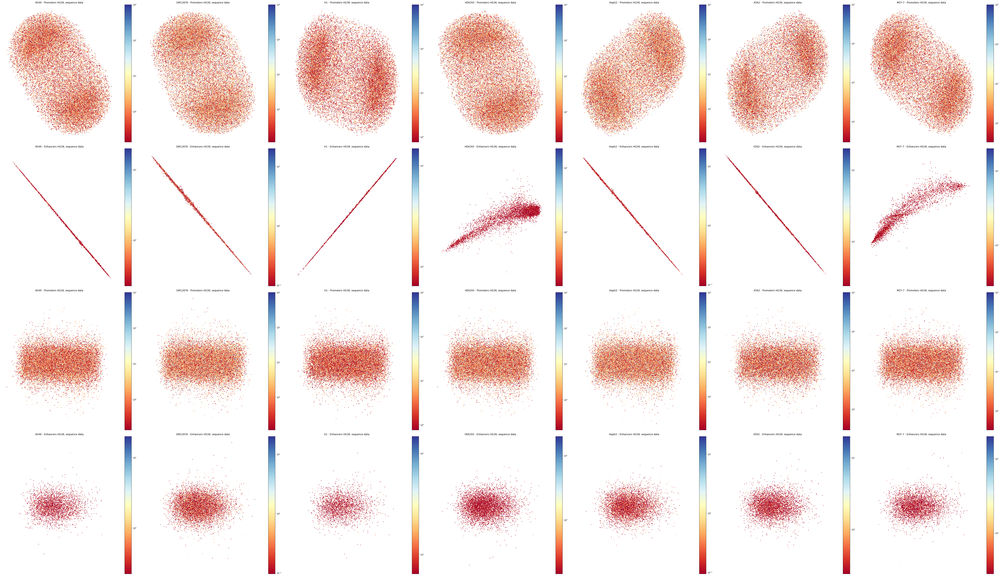

In [ ]:
epigenomic_fig, epigenomic_axes = plt.subplots(
    nrows=8,
    ncols=len(get_cell_lines()),
    figsize=(10*len(get_cell_lines()), 80),
    squeeze=False
)

sequence_fig, sequence_axes = plt.subplots(
    nrows=4,
    ncols=len(get_cell_lines()),
    figsize=(10*len(get_cell_lines()), 40),
    squeeze=False
)

for i, cell_line in enumerate(tqdm(get_cell_lines(), desc="Computing decompositions")):
    for k, metric in enumerate(tqdm(("max", "mean"), desc="Metrics", leave=False)):
        for l, decomposition_method in enumerate(tqdm((get_tsne_decomposition, get_pca_decomposition), desc="Decomposition method", leave=False)):
            for j, ((epigenomic, scores), region, clip_value) in enumerate(tqdm((
                (active_promoters_vs_inactive_promoters(cell_line=cell_line, metric=metric), "Promoters", 1000),
                (active_enhancers_vs_inactive_enhancers(cell_line=cell_line, metric=metric), "Enhancers", 20)
            ), desc="Task", leave=False)):
                # imputation and scaling of the data
                imputed_epigenomic = pd.DataFrame(
                    MinMaxScaler().fit_transform(
                        KNNImputer().fit_transform(epigenomic)
                    ),
                    columns=epigenomic.columns,
                    index=epigenomic.index
                )
                decomposed_epigenomic = decomposition_method(
                    imputed_epigenomic,
                    "epigenomic",
                    region,
                    cell_line,
                    metric = "euclidean",
                )
                scores[scores>clip_value] = clip_value
                scatter_with_heatmap(
                    decomposition=decomposed_epigenomic,
                    scores=scores.values,
                    figure=epigenomic_fig,
                    ax=epigenomic_axes[j + 2*k + l*4][i]
                )
                epigenomic_axes[j + 2*k + l*4][i].set_title(f"{cell_line} - {region} {metric} HG38, epigenomic data")
                epigenomic_axes[j + 2*k + l*4][i].set_axis_off()
                
                if k==0:
                    sequence = pd.DataFrame(
                        np.array(BedSequence(
                            genome,
                            bed=to_bed(scores),
                            batch_size=1
                        )).reshape(-1, 4*256),
                        index=scores.index
                    )
                    decomposed_sequence = decomposition_method(
                        sequence,
                        "sequence",
                        region,
                        cell_line,
                        metric="euclidean",
                        # It would be better to use the COSINE distance,
                        # but it is too terribly slow to be feaseable
                        # with all the considered use cases.
                        # distance_metric="cosine"
                    )
                    scatter_with_heatmap(
                        decomposition=decomposed_sequence,
                        scores=scores.values,
                        figure=sequence_fig,
                        ax=sequence_axes[j + l*2][i]
                    )
                    sequence_axes[j + l*2][i].set_title(f"{cell_line} - {region} HG38, sequence data")
                    sequence_axes[j + l*2][i].set_axis_off()

epigenomic_fig.tight_layout()
sequence_fig.tight_layout()
plt.show()

# Models:

### 1. Feed Forward Neural Network(FFNN) for epigenomic data
### 2.Convolutional Neural Network(CNN) for sequence data
### 3.Multi-model Neural Network(MMNN) for genomic and sequence data

In [18]:
def build_regression_perceptron(
    input_shape: int
)->Tuple[Model, Layer, Layer]:
    """Returns perceptron model for regression.
    
    Parameters
    -----------------------
    input_shape: int,
        Number of features in the input layer.
        
    Returns
    -----------------------
    Triple with model, input layer and output layer.
    """
    input_epigenomic_data = Input(shape=(input_shape,), name="epigenomic_data")
    output_ffnn = Dense(1, activation="linear")(input_epigenomic_data)

    perceptron = Model(
        inputs=input_epigenomic_data,
        outputs=output_ffnn,
        name="RegressionPerceptron"
    )

    perceptron.compile(
        optimizer=tf.keras.optimizers.Nadam(learning_rate = 2e-4),
        loss="mse",
        metrics=["mse"]
    )
    return perceptron, input_epigenomic_data, output_ffnn

In [19]:
def build_regression_ffnn(
    input_shape: int
)->Tuple[Model, Layer, Layer]:
    """Returns Feed-Forward Neural Network model for regression.
    
    Parameters
    -----------------------
    input_shape: int,
        Number of features in the input layer.
        
    Returns
    -----------------------
    Triple with model, input layer and output layer.
    """
    input_epigenomic_data = Input(shape=(input_shape,), name="epigenomic_data")
    hidden = Dense(128, activation="relu")(input_epigenomic_data)

    for _ in range(2):
        hidden = Dense(
            64,
            activation="relu",
        )(hidden)
        hidden = Dropout(rate=0.3)(hidden)

    last_hidden_ffnn = hidden
    output_ffnn = Dense(1, activation="linear")(input_epigenomic_data)

    ffnn = Model(
        inputs=input_epigenomic_data,
        outputs=output_ffnn,
        name="RegressionFFNN"
    )

    ffnn.compile(
        optimizer=tf.keras.optimizers.Nadam(learning_rate = 2e-4),
        loss="mse",
        metrics=["mse"]
    )
    return ffnn, input_epigenomic_data, last_hidden_ffnn

In [20]:
def build_regression_cnn(
    window_size: int
)->Tuple[Model, Layer, Layer]:
    """Returns Convolutional Neural Network model for regression.
    
    Parameters
    -----------------------
    window_size: int,
        Size of the input genomic window.
        
    Returns
    -----------------------
    Triple with model, input layer and output layer.
    """
    input_sequence_data = Input(shape=(window_size, 4), name="sequence_data")
    hidden = Conv1D(32, kernel_size=5, activation="relu")(input_sequence_data)

    for _ in range(2):
        hidden = Conv1D(
            64,
            kernel_size=3,
            activation="relu",
        )(hidden)
        hidden = Dropout(rate=0.3)(hidden)
        hidden = MaxPool1D(pool_size=2)(hidden)
        
    hidden = GlobalAveragePooling1D()(hidden)
    last_hidden_cnn = Dense(64, activation="relu")(hidden)
    output_cnn = Dense(1, activation="linear")(last_hidden_cnn)

    cnn = Model(
        inputs=input_sequence_data,
        outputs=output_cnn,
        name="RegressionCNN"
    )

    cnn.compile(
        optimizer=tf.keras.optimizers.Nadam(learning_rate = 2e-4),
        loss="mse",
        metrics=["mse"]
    )
    return cnn, input_sequence_data, last_hidden_cnn

In [21]:
def build_regression_mmnn(
    input_shape: Optional[int] = None,
    window_size: Optional[int] = None,
    input_epigenomic_data: Optional[Layer] = None,
    input_sequence_data: Optional[Layer] = None,
    last_hidden_ffnn: Optional[Layer] = None,
    last_hidden_cnn: Optional[Layer] = None,
):
    """Returns Multi-Modal Neural Network model for regression.
    
    Implementative details
    -----------------------
    If the input shape / window size is not provided and the input layers and 
    the feature selection layers are provided, then the network will start
    to train from those layers (which are expected to be pre-trained).
    Conversely, it will create the submodules for the epigenomic and sequence
    data ex-novo.
    
    Parameters
    -----------------------
    input_shape: Optional[int] = None,
        Number of features in the input layer.
        Either the input shape or the input and output layers of the FFNN
        must be provided.
    window_size: int,
        Size of the input genomic window.
        Either the window size or the input and output layers of the CNN
        must be provided.
    input_epigenomic_data: Optional[Layer] = None,
        Input for the epigenomic data from a FFNN model.
        Either the input shape or the input and output layers of the FFNN
        must be provided.
    input_sequence_data: Optional[Layer] = None,
        Input for the sequence data from a CNN model.
        Either the window size or the input and output layers of the CNN
        must be provided.
    last_hidden_ffnn: Optional[Layer] = None,
        Feature selection layer from a FFNN model.    
        Either the input shape or the input and output layers of the FFNN
        must be provided.
    last_hidden_cnn: Optional[Layer] = None,
        Feature selection layer from a CNN model.
        Either the window size or the input and output layers of the CNN
        must be provided.
        
    Raises
    -----------------------
    ValueError,
        If the input shape is not provided and the input layer and feature selection
        layer of the FFNN are not provided.
    ValueError,
        If the window size is not provided and the input layer and feature selection
        layer of the CNN are not provided.
        
    Returns
    -----------------------
    Triple with model, input layer and output layer.
    """
    if input_shape is None and (last_hidden_ffnn is None or input_epigenomic_data is None):
        raise ValueError(
            "Either the input shape or the features selection layer and the input epigenomic "
            "layer must be provided."
        )
    if window_size is None and (last_hidden_cnn is None or input_sequence_data is None):
        raise ValueError(
            "Either the input shape or the features selection layer and the input sequence "
            "layer must be provided."
        )
        
    if input_shape is not None:
        _, input_epigenomic_data, last_hidden_ffnn = build_regression_ffnn(input_shape)
        
    if window_size is not None:
        _, input_sequence_data, last_hidden_cnn = build_regression_cnn(window_size)
        
    concatenation_layer = Concatenate()([
        last_hidden_ffnn,
        last_hidden_cnn
    ])

    last_hidden_mmnn = Dense(64, activation="relu")(concatenation_layer)
    output_mmnn = Dense(1, activation="linear")(last_hidden_mmnn)

    mmnn = Model(
        inputs=[input_epigenomic_data, input_sequence_data],
        outputs=output_mmnn,
        name="BoostedRegressionMMNN" if input_shape is None else "RegressionMMNN"
    )

    mmnn.compile(
        optimizer=tf.keras.optimizers.Nadam(learning_rate = 2e-4),
        loss="mse",
        metrics=["mse"]
    )

    return mmnn

In [22]:
def get_cnn_sequence(
    genome: Genome,
    bed: pd.DataFrame,
    y: np.ndarray,
    batch_size: int = 1024
) -> MixedSequence:
    """Returns sequence to train a CNN model on genomic sequences.
    
    Implementative details
    -------------------------
    This sequence can be used for either binary classification or
    for regresssion, just change the y accordingly.
    
    Parameters
    -------------------------
    genome: Genome,
        The genome from where to extract the genomic sequence.
    bed: pd.DataFrame,
        The BED file coordinates describing where to extract the sequences.
    y: np.ndarray,
        The values the model should predict.
    batch_size: int = 1024,
        The size of the batches to generate
    
    Returns
    --------------------------
    MixedSequence object to train a CNN.
    """
    return MixedSequence(
        x={
            "sequence_data": BedSequence(
                genome,
                bed,
                batch_size=batch_size,
            )
        },
        y=VectorSequence(
            y,
            batch_size=batch_size
        )
    )

def get_ffnn_sequence(
    X: np.ndarray,
    y: np.ndarray,
    batch_size: int = 1024
) -> MixedSequence:
    """Returns sequence to train a FFNN model on epigenomic data.
    
    Implementative details
    -------------------------
    This sequence can be used for either binary classification or
    for regresssion, just change the y accordingly.
    
    Parameters
    -------------------------
    X: np.ndarray,
        The vector from where to extract the epigenomic data.
    y: np.ndarray,
        The values the model should predict.
    batch_size: int = 1024,
        The size of the batches to generate
    
    Returns
    --------------------------
    MixedSequence object to train a FFNN.
    """
    return MixedSequence(
        x={
            "epigenomic_data": VectorSequence(
                X,
                batch_size
            )
        },
        y=VectorSequence(
            y,
            batch_size=batch_size
        )
    )

def get_mmnn_sequence(
    genome: Genome,
    bed: pd.DataFrame,
    X: np.ndarray,
    y: np.ndarray,
    batch_size: int = 1024
) -> MixedSequence:
    """Returns sequence to train a MMNN model on both genomic sequences and epigenomic data.
    
    Implementative details
    -------------------------
    This sequence can be used for either binary classification or
    for regresssion, just change the y accordingly.
    
    Parameters
    -------------------------
    genome: Genome,
        The genome from where to extract the genomic sequence.
    bed: pd.DataFrame,
        The BED file coordinates describing where to extract the sequences.
    X: np.ndarray,
        The vector from where to extract the epigenomic data.
    y: np.ndarray,
        The values the model should predict.
    batch_size: int = 1024,
        The size of the batches to generate
    
    Returns
    --------------------------
    MixedSequence object to train a MMNN.
    """
    return MixedSequence(
        x={
            "sequence_data": BedSequence(
                genome,
                bed,
                batch_size=batch_size,
            ),
            "epigenomic_data": VectorSequence(
                X,
                batch_size
            )
        },
        y=VectorSequence(
            y,
            batch_size=batch_size
        )
    )

In [23]:
@Cache(
    cache_path=[
        "model_histories/{cell_line}/{task}/{model_name}/history_{_hash}.csv.xz",
        "model_performance/{cell_line}/{task}/{model_name}/performance_{_hash}.csv.xz",
    ],
    args_to_ignore=[
        "model", "training_sequence", "test_sequence"
    ]
)
def train_model(
    model: Model,
    model_name: str,
    task: str,
    cell_line: str,
    training_sequence: MixedSequence,
    test_sequence: MixedSequence,
    holdout_number: int, 
    UFS
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    """Returns training history and model evaluations.
    
    Parameters
    ---------------------
    model: Model,
        The model to train.
    model_name: str,
        The model name.
    task: str,
        The name of the task.
    cell_line: str,
        Name of the considered cell line.
    training_sequence: MixedSequence,
        The training sequence.
    test_sequence: MixedSequence,
        The test sequence.
    holdout_number: int,
        The number of the current holdout.
        
    Returns
    ----------------------
    Tuple with training history dataframe and model evaluations dataframe.
    """
    history = pd.DataFrame(model.fit(
        train_sequence,
        validation_data=test_sequence,
        epochs=1000,
        verbose=False,
        callbacks=[
            EarlyStopping(
                "val_loss",
                min_delta=0,
                patience=3,
                mode="min"
            ),
            # I have commented this because we do not need this loading bar
            # when running the main experiment loop. When you experiment with
            # the model structure you may want to enable this to get a feel
            # of how the model is performing during the training.
            # TqdmCallback(verbose=1)
        ]
    ).history)
    
    train_evaluation = dict(zip(model.metrics_names, model.evaluate(train_sequence, verbose=False)))
    test_evaluation = dict(zip(model.metrics_names, model.evaluate(test_sequence, verbose=False)))
    train_evaluation["run_type"] = "train"
    test_evaluation["run_type"] = "test"
    
    for evaluation in (train_evaluation, test_evaluation):
        evaluation["model_name"] = model_name
        evaluation["task"] = task
        evaluation["holdout_number"] = holdout_number
    
    if UFS:
        train_evaluation['use_feature_selection'] = 'True'
        test_evaluation['use_feature_selection'] = 'True'
    else:
        train_evaluation['use_feature_selection'] = 'False'
        test_evaluation['use_feature_selection'] = 'False'
        
    evaluations = pd.DataFrame([
        train_evaluation,
        test_evaluation
    ])
    
    return history, evaluations

# Model evaluation:
#### Here we have generated holdout. 

In [61]:
# Here for speed sake we are only doing two holdouts
# but normally at least 10 are executed
number_of_splits = 2

regression_holdouts_generator = ShuffleSplit(
    n_splits=number_of_splits,
    test_size=0.2
)

In [51]:
warnings.filterwarnings('ignore')

# Create a list to store all the computed performance
all_regression_performance = []
window_size = 256
cell_line = "K562"

for FSM in tqdm([True, False], desc = "Feature selection mode", leave =False):
    for task in tqdm((
        active_enhancers_vs_inactive_enhancers,
        active_promoters_vs_inactive_promoters,
    ), desc="Tasks"):
        task_name = task.__name__
        # We get the task data with continuous values
        # and we clip the ys at 10, then normalize
        # these values between 0 and 1.
        X, y = task(
            window_size=window_size,
            cell_line=cell_line
        )
        # Clipping
        y[y>10] = 10
        # Normalizing
        y /= 10
        # Extract the bed coordinates from the epigenomic dataset
        bed = to_bed(X)

        # Start the main loop, iterating through the holdouts
        for holdout_number, (train_indices, test_indices) in tqdm(
            enumerate(regression_holdouts_generator.split(X, y)),
            total=number_of_splits,
            leave=False,
            desc="Computing holdouts"
        ):
            # Get the training and test data
            train_bed, test_bed = bed.copy().iloc[train_indices], bed.copy().iloc[test_indices]
            train_X, test_X = X.copy().iloc[train_indices], X.copy().iloc[test_indices]
            train_y, test_y = y.copy().iloc[train_indices], y.copy().iloc[test_indices]
            # Impute and normalize the epigenomic data
            train_X, test_X = normalize_epigenomic_data(train_X, test_X)

            # Flatten the output values
            train_y = train_y.values.flatten()
            test_y = test_y.values.flatten()





            if FSM:
                feature_indexs = spearman_feature_selection(train_X, train_y, n_features = 429)
                train_X = train_X[:, feature_indexs]
                test_X  = test_X[:, feature_indexs]
            # Get the number of features of this specific dataset
            number_of_features = train_X.shape[1]

            perceptron, _, _ = build_regression_perceptron(number_of_features)
            ffnn, input_epigenomic_data, last_hidden_ffnn = build_regression_ffnn(number_of_features)
            cnn, input_sequence_data, last_hidden_cnn = build_regression_cnn(window_size)
            mmnn1 = build_regression_mmnn(number_of_features, window_size)
            mmnn2 = build_regression_mmnn(
                input_sequence_data=input_sequence_data,
                input_epigenomic_data=input_epigenomic_data,
                last_hidden_ffnn=last_hidden_ffnn,
                last_hidden_cnn=last_hidden_cnn
            )

            for model, train_sequence, test_sequence in tqdm(
                (
                    (perceptron, get_ffnn_sequence(train_X, train_y), get_ffnn_sequence(test_X, test_y)),
                    (ffnn, get_ffnn_sequence(train_X, train_y), get_ffnn_sequence(test_X, test_y)),
                    (cnn, get_cnn_sequence(genome, train_bed, train_y), get_cnn_sequence(genome, test_bed, test_y)),
                    (mmnn1, get_mmnn_sequence(genome, train_bed, train_X, train_y), get_mmnn_sequence(genome, test_bed, test_X, test_y)),
                    (mmnn2, get_mmnn_sequence(genome, train_bed, train_X, train_y), get_mmnn_sequence(genome, test_bed, test_X, test_y)),
                ),
                desc="Training models",
                leave=False
            ):

                    # We compute the model performance
                history, performance = train_model(
                    model,
                    model.name,
                    task_name,
                    cell_line,
                    train_sequence,
                    test_sequence,
                    holdout_number,
                    UFS = FSM
                )
                # We chain the computed performance to the performance list
                all_regression_performance.append(performance)
                
                del history
                del train_sequence, test_sequence
                tf.keras.backend.clear_session()
                gc.collect()
                
            del train_X, test_X
            del train_bed, test_bed
            tf.keras.backend.clear_session()
            gc.collect()
        
# We convert the computed performance list into a DataFrame
all_regression_performance = pd.concat(all_regression_performance)

Feature selection mode:   0%|          | 0/2 [00:00<?, ?it/s]

Tasks:   0%|          | 0/2 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Training models:   0%|          | 0/5 [00:00<?, ?it/s]

Training models:   0%|          | 0/5 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Training models:   0%|          | 0/5 [00:00<?, ?it/s]

Training models:   0%|          | 0/5 [00:00<?, ?it/s]

Tasks:   0%|          | 0/2 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Training models:   0%|          | 0/5 [00:00<?, ?it/s]

Training models:   0%|          | 0/5 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Training models:   0%|          | 0/5 [00:00<?, ?it/s]

Training models:   0%|          | 0/5 [00:00<?, ?it/s]

# Results(with feature selection and without feture selection)

In [55]:
all_regression_performance

,loss,mse,run_type,model_name,task,holdout_number,use_feature_selection
0,0.000872,0.000872,train,RegressionPerceptron,active_enhancers_vs_inactive_enhancers,0,True
1,0.001204,0.001204,test,RegressionPerceptron,active_enhancers_vs_inactive_enhancers,0,True
0,0.000860,0.000860,train,RegressionFFNN,active_enhancers_vs_inactive_enhancers,0,True
1,0.001199,0.001199,test,RegressionFFNN,active_enhancers_vs_inactive_enhancers,0,True
0,0.000974,0.000974,train,RegressionCNN,active_enhancers_vs_inactive_enhancers,0,True
...,...,...,...,...,...,...,...
1,0.082608,0.082608,test,RegressionCNN,active_promoters_vs_inactive_promoters,1,False
0,0.056565,0.056565,train,RegressionMMNN,active_promoters_vs_inactive_promoters,1,False
1,0.057345,0.057345,test,RegressionMMNN,active_promoters_vs_inactive_promoters,1,False
0,0.053827,0.053827,train,BoostedRegressionMMNN,active_promoters_vs_inactive_promoters,1,False


In [56]:
for model in all_regression_performance.model_name.unique():
    model_performance = all_regression_performance[(all_regression_performance.model_name == model) & (all_regression_performance.run_type == "test")]
    performance_with_feature_selection = model_performance[
        model_performance.use_feature_selection == "True"
    ]
    performance_without_feature_selection = model_performance[
        model_performance.use_feature_selection == "False"
    ]

    for metric in ("loss", "mse"):
        print(
            model,
            metric,
            wilcoxon(performance_with_feature_selection[metric], performance_without_feature_selection[metric])
        )

RegressionPerceptron loss WilcoxonResult(statistic=1.0, pvalue=0.25)
RegressionPerceptron mse WilcoxonResult(statistic=1.0, pvalue=0.25)
RegressionFFNN loss WilcoxonResult(statistic=1.0, pvalue=0.25)
RegressionFFNN mse WilcoxonResult(statistic=1.0, pvalue=0.25)
RegressionCNN loss WilcoxonResult(statistic=1.0, pvalue=0.25)
RegressionCNN mse WilcoxonResult(statistic=1.0, pvalue=0.25)
RegressionMMNN loss WilcoxonResult(statistic=1.0, pvalue=0.25)
RegressionMMNN mse WilcoxonResult(statistic=1.0, pvalue=0.25)
BoostedRegressionMMNN loss WilcoxonResult(statistic=1.0, pvalue=0.25)
BoostedRegressionMMNN mse WilcoxonResult(statistic=1.0, pvalue=0.25)


Rendering barplots:   0%|                                                                        | 0/2 [00:00<…

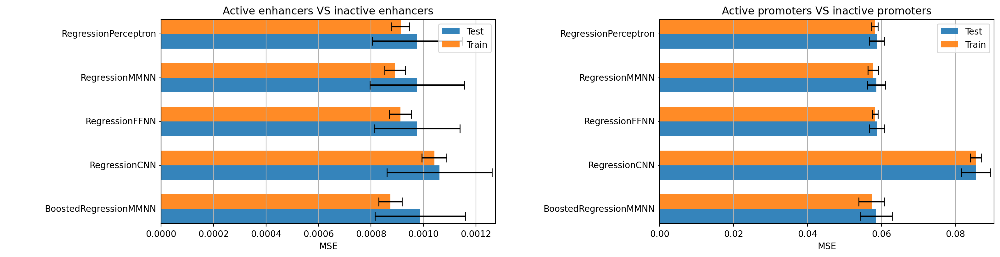

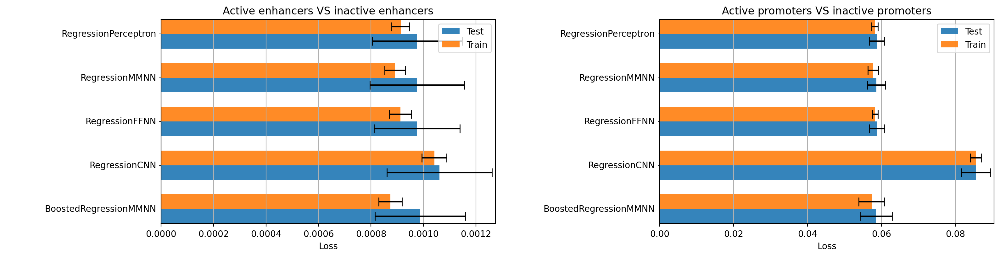

In [57]:
fig, ax = barplots(
    all_regression_performance.drop(columns=["holdout_number"]),
    groupby=["task", "model_name", "run_type"],
    orientation="horizontal",
    height = 8,
    
    show_legend=True,
    subplots=True
)

ax[0][0].plot()
plt.show()